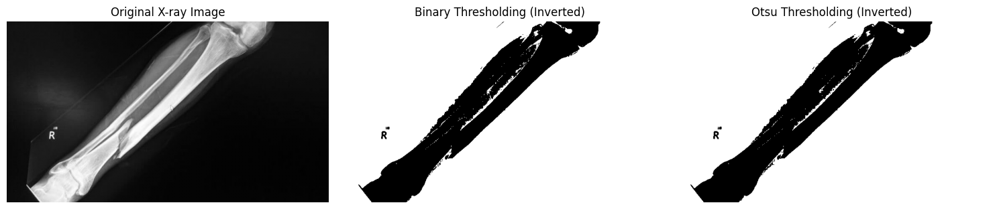

Binary threshold applied with threshold value: 100
Otsu threshold applied automatically
Segmented images saved as 'binary_threshold.jpg' and 'otsu_threshold.jpg'


In [2]:
#TASK 1
import cv2
import numpy as np
import matplotlib.pyplot as plt

img = cv2.imread('/content/bone fracture.jpg', cv2.IMREAD_GRAYSCALE)

_, binary_threshold = cv2.threshold(img, 100, 255, cv2.THRESH_BINARY_INV)

otsu_threshold = cv2.threshold(img, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]

plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1)
plt.imshow(img, cmap='gray')
plt.title('Original X-ray Image')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(binary_threshold, cmap='gray')
plt.title('Binary Thresholding (Inverted)')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(otsu_threshold, cmap='gray')
plt.title('Otsu Thresholding (Inverted)')
plt.axis('off')

plt.tight_layout()
plt.show()

cv2.imwrite('binary_threshold.jpg', binary_threshold)
cv2.imwrite('otsu_threshold.jpg', otsu_threshold)

print("Binary threshold applied with threshold value: 100")
print("Otsu threshold applied automatically")
print("Segmented images saved as 'binary_threshold.jpg' and 'otsu_threshold.jpg'")

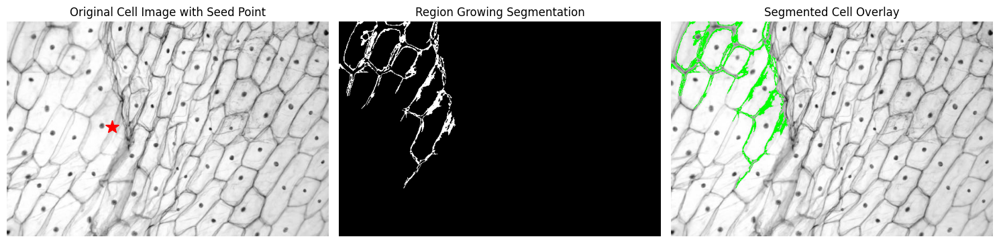

Seed point: (200, 200)
Intensity threshold: 15
Segmented pixels: 6940


In [3]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from collections import deque

img = cv2.imread('/content/microscopecells.jpg', cv2.IMREAD_GRAYSCALE)

seed_point = (200, 200)
threshold = 15

segmented = np.zeros_like(img)
visited = np.zeros_like(img, dtype=bool)

queue = deque([seed_point])
visited[seed_point[1], seed_point[0]] = True
seed_intensity = float(img[seed_point[1], seed_point[0]])

while queue:
    x, y = queue.popleft()
    segmented[y, x] = 255

    for dx, dy in [(-1, 0), (1, 0), (0, -1), (0, 1), (-1, -1), (-1, 1), (1, -1), (1, 1)]:
        nx, ny = x + dx, y + dy

        if 0 <= nx < img.shape[1] and 0 <= ny < img.shape[0]:
            if not visited[ny, nx]:
                if abs(float(img[ny, nx]) - seed_intensity) < threshold:
                    queue.append((nx, ny))
                    visited[ny, nx] = True

plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1)
plt.imshow(img, cmap='gray')
plt.plot(seed_point[0], seed_point[1], 'r*', markersize=15)
plt.title('Original Cell Image with Seed Point')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(segmented, cmap='gray')
plt.title('Region Growing Segmentation')
plt.axis('off')

plt.subplot(1, 3, 3)
overlay = cv2.cvtColor(img, cv2.COLOR_GRAY2BGR)
overlay[segmented > 0] = [0, 255, 0]
plt.imshow(overlay)
plt.title('Segmented Cell Overlay')
plt.axis('off')

plt.tight_layout()
plt.show()

cv2.imwrite('region_growing_result.jpg', segmented)

print(f"Seed point: {seed_point}")
print(f"Intensity threshold: {threshold}")
print(f"Segmented pixels: {np.sum(segmented > 0)}")

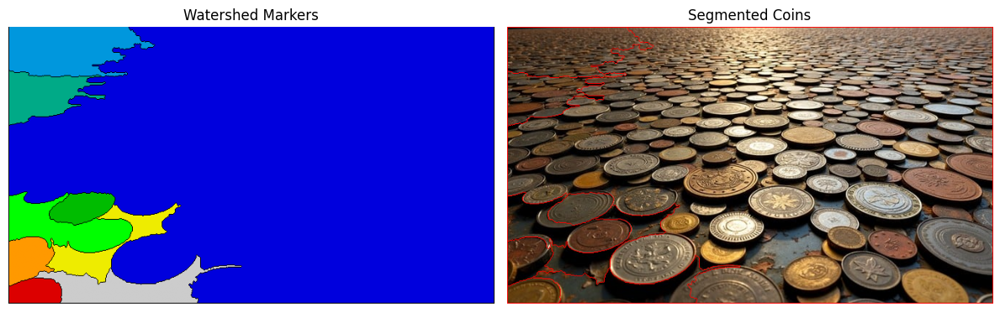

Number of coins detected: 8


In [4]:
# task 3

import cv2
import numpy as np
import matplotlib.pyplot as plt
from scipy import ndimage

img = cv2.imread('/content/coins.jpg')

gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

blurred = cv2.GaussianBlur(gray, (5, 5), 0)

_, thresh = cv2.threshold(blurred, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)

kernel = np.ones((3, 3), np.uint8)
opening = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, kernel, iterations=2)

sure_bg = cv2.dilate(opening, kernel, iterations=3)

dist_transform = cv2.distanceTransform(opening, cv2.DIST_L2, 5)
_, sure_fg = cv2.threshold(dist_transform, 0.5 * dist_transform.max(), 255, 0)

sure_fg = np.uint8(sure_fg)
unknown = cv2.subtract(sure_bg, sure_fg)

_, markers = cv2.connectedComponents(sure_fg)

markers = markers + 1
markers[unknown == 255] = 0

markers = cv2.watershed(img, markers)

coin_count = len(np.unique(markers)) - 2

plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.imshow(markers, cmap='nipy_spectral')
plt.title('Watershed Markers')
plt.axis('off')

plt.subplot(1, 2, 2)
result = img.copy()
result[markers == -1] = [0, 0, 255]
plt.imshow(cv2.cvtColor(result, cv2.COLOR_BGR2RGB))
plt.title('Segmented Coins')
plt.axis('off')

plt.tight_layout()
plt.show()

print(f"Number of coins detected: {coin_count}")

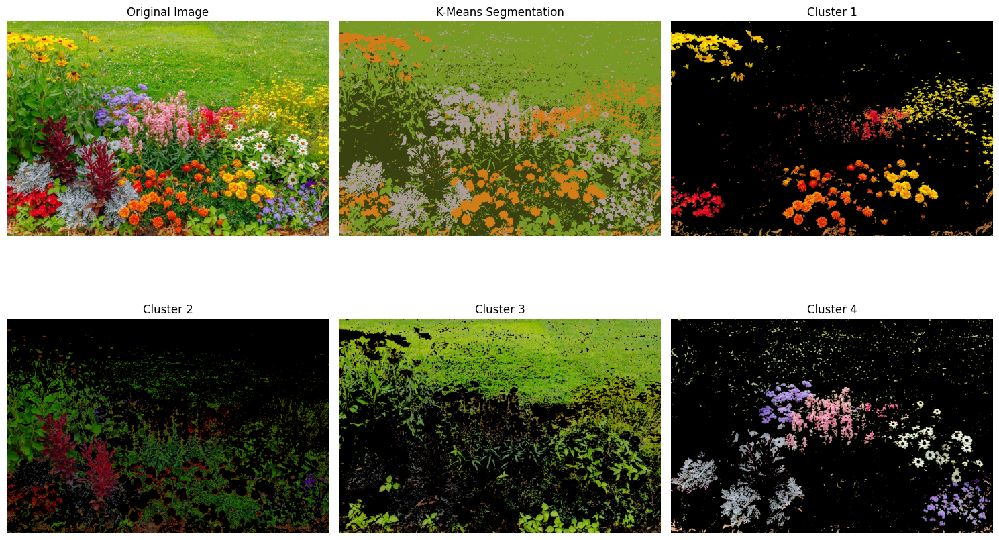

Number of clusters: 4
Cluster centers (RGB):
Cluster 1: [211 125  25]
Cluster 2: [56 65 15]
Cluster 3: [121 153  37]
Cluster 4: [173 158 155]


In [8]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

img = cv2.imread('flowers.webp')

img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

pixels = img_rgb.reshape((-1, 3))
pixels = np.float32(pixels)

n_clusters = 4

kmeans = KMeans(n_clusters=n_clusters, random_state=42, n_init=10)
labels = kmeans.fit_predict(pixels)
centers = np.uint8(kmeans.cluster_centers_)

segmented_image = centers[labels.flatten()]
segmented_image = segmented_image.reshape(img_rgb.shape)

plt.figure(figsize=(15, 10))

plt.subplot(2, 3, 1)
plt.imshow(img_rgb)
plt.title('Original Image')
plt.axis('off')

plt.subplot(2, 3, 2)
plt.imshow(segmented_image)
plt.title('K-Means Segmentation')
plt.axis('off')

for i in range(n_clusters):
    mask = labels.reshape(img_rgb.shape[:2]) == i
    cluster_img = np.zeros_like(img_rgb)
    cluster_img[mask] = img_rgb[mask]

    plt.subplot(2, 3, 3 + i)
    plt.imshow(cluster_img)
    plt.title(f'Cluster {i+1}')
    plt.axis('off')

plt.tight_layout()
plt.show()

print(f"Number of clusters: {n_clusters}")
print(f"Cluster centers (RGB):")
for i, center in enumerate(centers):
    print(f"Cluster {i+1}: {center}")

Taking reference image...


<IPython.core.display.Javascript object>


Taking test image...


<IPython.core.display.Javascript object>


Object detected with 12 matching features


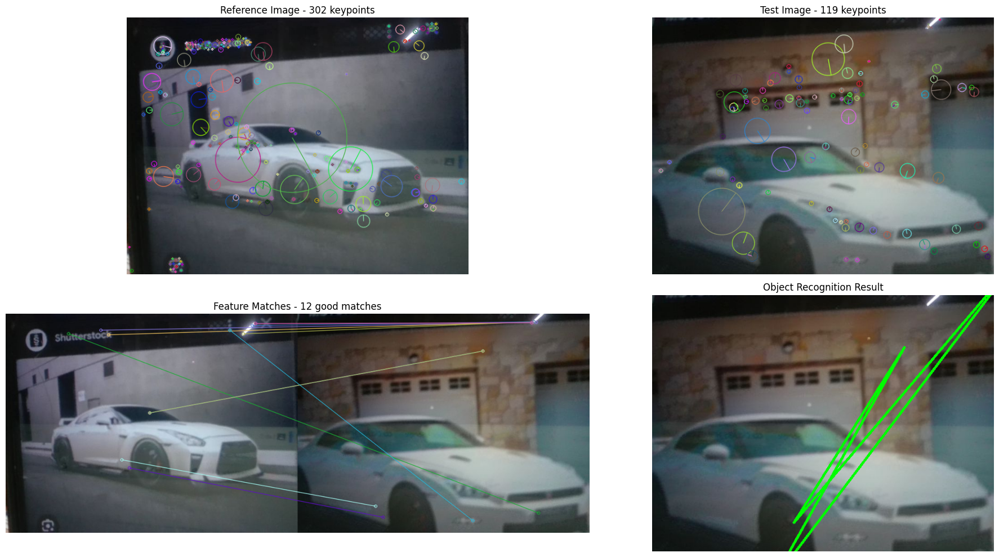

In [14]:
# TASK 1 -LAb 5B

import cv2
import numpy as np
import matplotlib.pyplot as plt
from google.colab import output
from IPython.display import display, Javascript
from google.colab.patches import cv2_imshow
from base64 import b64decode

def take_photo(filename='photo.jpg', quality=0.8):
    js = Javascript('''
        async function takePhoto(quality) {
            const div = document.createElement('div');
            const capture = document.createElement('button');
            capture.textContent = 'Capture';
            div.appendChild(capture);

            const video = document.createElement('video');
            video.style.display = 'block';
            const stream = await navigator.mediaDevices.getUserMedia({video: true});

            document.body.appendChild(div);
            div.appendChild(video);
            video.srcObject = stream;
            await video.play();

            google.colab.output.setIframeHeight(document.documentElement.scrollHeight, true);

            await new Promise((resolve) => capture.onclick = resolve);

            const canvas = document.createElement('canvas');
            canvas.width = video.videoWidth;
            canvas.height = video.videoHeight;
            canvas.getContext('2d').drawImage(video, 0, 0);
            stream.getVideoTracks()[0].stop();
            div.remove();
            return canvas.toDataURL('image/jpeg', quality);
        }
        ''')
    display(js)
    data = output.eval_js('takePhoto({})'.format(quality))
    binary = b64decode(data.split(',')[1])
    with open(filename, 'wb') as f:
        f.write(binary)
    return filename

print("Taking reference image...")
ref_file = take_photo('reference.jpg')
reference_img = cv2.imread(ref_file)

print("\nTaking test image...")
test_file = take_photo('test.jpg')
test_img = cv2.imread(test_file)

reference_gray = cv2.cvtColor(reference_img, cv2.COLOR_BGR2GRAY)
test_gray = cv2.cvtColor(test_img, cv2.COLOR_BGR2GRAY)

sift = cv2.SIFT_create()

keypoints_ref, descriptors_ref = sift.detectAndCompute(reference_gray, None)
keypoints_test, descriptors_test = sift.detectAndCompute(test_gray, None)

bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=False)
matches = bf.knnMatch(descriptors_ref, descriptors_test, k=2)

good_matches = []
for m, n in matches:
    if m.distance < 0.75 * n.distance:
        good_matches.append(m)

if len(good_matches) > 10:
    src_pts = np.float32([keypoints_ref[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2)
    dst_pts = np.float32([keypoints_test[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)

    M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)

    h, w = reference_gray.shape
    pts = np.float32([[0, 0], [0, h-1], [w-1, h-1], [w-1, 0]]).reshape(-1, 1, 2)
    dst = cv2.perspectiveTransform(pts, M)

    result_img = test_img.copy()
    cv2.polylines(result_img, [np.int32(dst)], True, (0, 255, 0), 3)

    print(f"\nObject detected with {len(good_matches)} matching features")
else:
    result_img = test_img.copy()
    print(f"\nInsufficient matches found: {len(good_matches)}/10")

match_img = cv2.drawMatches(reference_img, keypoints_ref, test_img, keypoints_test,
                             good_matches[:50], None,
                             flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

plt.figure(figsize=(20, 10))

plt.subplot(2, 2, 1)
ref_kp_img = cv2.drawKeypoints(reference_img, keypoints_ref, None,
                                flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
plt.imshow(cv2.cvtColor(ref_kp_img, cv2.COLOR_BGR2RGB))
plt.title(f'Reference Image - {len(keypoints_ref)} keypoints')
plt.axis('off')

plt.subplot(2, 2, 2)
test_kp_img = cv2.drawKeypoints(test_img, keypoints_test, None,
                                flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
plt.imshow(cv2.cvtColor(test_kp_img, cv2.COLOR_BGR2RGB))
plt.title(f'Test Image - {len(keypoints_test)} keypoints')
plt.axis('off')

plt.subplot(2, 2, 3)
plt.imshow(cv2.cvtColor(match_img, cv2.COLOR_BGR2RGB))
plt.title(f'Feature Matches - {len(good_matches)} good matches')
plt.axis('off')

plt.subplot(2, 2, 4)
plt.imshow(cv2.cvtColor(result_img, cv2.COLOR_BGR2RGB))
plt.title('Object Recognition Result')
plt.axis('off')

plt.tight_layout()
plt.show()

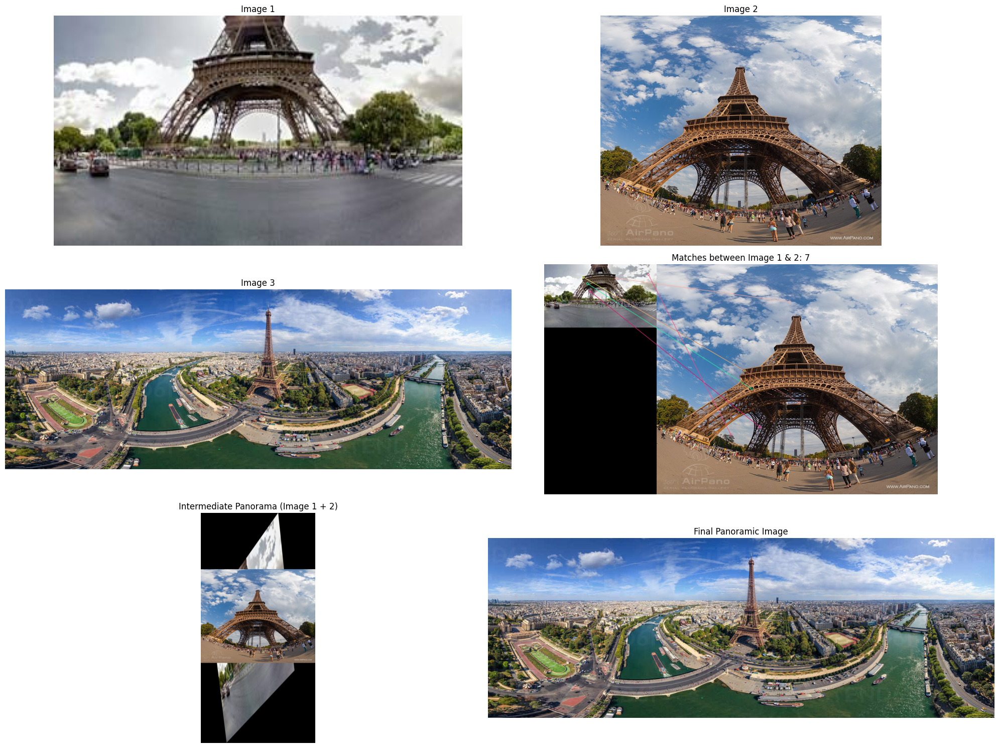

Image 1 keypoints: 619
Image 2 keypoints: 2672
Image 3 keypoints: 5375
Good matches (1-2): 7
Good matches (panorama-3): 13
Final panorama size: 1232x438


In [16]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

img1 = cv2.imread('pano4.jpg')
img2 = cv2.imread('pano2.jpg')
img3 = cv2.imread('pano3.jpg')

if img1 is None:
    img1 = np.random.randint(50, 200, (400, 300, 3), dtype=np.uint8)
    cv2.rectangle(img1, (50, 100), (150, 300), (100, 150, 200), -1)
    cv2.circle(img1, (100, 200), 50, (150, 100, 50), -1)

if img2 is None:
    img2 = np.random.randint(50, 200, (400, 300, 3), dtype=np.uint8)
    cv2.rectangle(img2, (0, 100), (100, 300), (100, 150, 200), -1)
    cv2.circle(img2, (50, 200), 50, (150, 100, 50), -1)
    cv2.rectangle(img2, (150, 150), (250, 250), (200, 100, 100), -1)

if img3 is None:
    img3 = np.random.randint(50, 200, (400, 300, 3), dtype=np.uint8)
    cv2.rectangle(img3, (50, 150), (150, 250), (200, 100, 100), -1)
    cv2.circle(img3, (200, 200), 40, (100, 200, 150), -1)

gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)
gray3 = cv2.cvtColor(img3, cv2.COLOR_BGR2GRAY)

sift = cv2.SIFT_create()

kp1, des1 = sift.detectAndCompute(gray1, None)
kp2, des2 = sift.detectAndCompute(gray2, None)
kp3, des3 = sift.detectAndCompute(gray3, None)

bf = cv2.BFMatcher()

matches12 = bf.knnMatch(des1, des2, k=2)
good_matches12 = []
for m, n in matches12:
    if m.distance < 0.75 * n.distance:
        good_matches12.append(m)

src_pts = np.float32([kp1[m.queryIdx].pt for m in good_matches12]).reshape(-1, 1, 2)
dst_pts = np.float32([kp2[m.trainIdx].pt for m in good_matches12]).reshape(-1, 1, 2)

H12, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)

h1, w1 = img1.shape[:2]
h2, w2 = img2.shape[:2]

pts1 = np.float32([[0, 0], [0, h1], [w1, h1], [w1, 0]]).reshape(-1, 1, 2)
pts2 = np.float32([[0, 0], [0, h2], [w2, h2], [w2, 0]]).reshape(-1, 1, 2)

pts1_transformed = cv2.perspectiveTransform(pts1, H12)
pts = np.concatenate((pts1_transformed, pts2), axis=0)

[xmin, ymin] = np.int32(pts.min(axis=0).ravel() - 0.5)
[xmax, ymax] = np.int32(pts.max(axis=0).ravel() + 0.5)

translation = [-xmin, -ymin]
H_translation = np.array([[1, 0, translation[0]], [0, 1, translation[1]], [0, 0, 1]])

panorama12 = cv2.warpPerspective(img1, H_translation.dot(H12), (xmax - xmin, ymax - ymin))
panorama12[translation[1]:h2 + translation[1], translation[0]:w2 + translation[0]] = img2

gray_pano12 = cv2.cvtColor(panorama12, cv2.COLOR_BGR2GRAY)
kp_pano, des_pano = sift.detectAndCompute(gray_pano12, None)

matches23 = bf.knnMatch(des_pano, des3, k=2)
good_matches23 = []
for m, n in matches23:
    if m.distance < 0.75 * n.distance:
        good_matches23.append(m)

src_pts2 = np.float32([kp_pano[m.queryIdx].pt for m in good_matches23]).reshape(-1, 1, 2)
dst_pts2 = np.float32([kp3[m.trainIdx].pt for m in good_matches23]).reshape(-1, 1, 2)

H23, mask2 = cv2.findHomography(src_pts2, dst_pts2, cv2.RANSAC, 5.0)

h_pano, w_pano = panorama12.shape[:2]
h3, w3 = img3.shape[:2]

pts_pano = np.float32([[0, 0], [0, h_pano], [w_pano, h_pano], [w_pano, 0]]).reshape(-1, 1, 2)
pts3 = np.float32([[0, 0], [0, h3], [w3, h3], [w3, 0]]).reshape(-1, 1, 2)

pts_pano_transformed = cv2.perspectiveTransform(pts_pano, H23)
pts_final = np.concatenate((pts_pano_transformed, pts3), axis=0)

[xmin_final, ymin_final] = np.int32(pts_final.min(axis=0).ravel() - 0.5)
[xmax_final, ymax_final] = np.int32(pts_final.max(axis=0).ravel() + 0.5)

translation_final = [-xmin_final, -ymin_final]
H_translation_final = np.array([[1, 0, translation_final[0]], [0, 1, translation_final[1]], [0, 0, 1]])

final_panorama = cv2.warpPerspective(panorama12, H_translation_final.dot(H23), (xmax_final - xmin_final, ymax_final - ymin_final))
final_panorama[translation_final[1]:h3 + translation_final[1], translation_final[0]:w3 + translation_final[0]] = img3

plt.figure(figsize=(20, 15))

plt.subplot(3, 2, 1)
plt.imshow(cv2.cvtColor(img1, cv2.COLOR_BGR2RGB))
plt.title('Image 1')
plt.axis('off')

plt.subplot(3, 2, 2)
plt.imshow(cv2.cvtColor(img2, cv2.COLOR_BGR2RGB))
plt.title('Image 2')
plt.axis('off')

plt.subplot(3, 2, 3)
plt.imshow(cv2.cvtColor(img3, cv2.COLOR_BGR2RGB))
plt.title('Image 3')
plt.axis('off')

plt.subplot(3, 2, 4)
match_img12 = cv2.drawMatches(img1, kp1, img2, kp2, good_matches12[:30], None, flags=2)
plt.imshow(cv2.cvtColor(match_img12, cv2.COLOR_BGR2RGB))
plt.title(f'Matches between Image 1 & 2: {len(good_matches12)}')
plt.axis('off')

plt.subplot(3, 2, 5)
plt.imshow(cv2.cvtColor(panorama12, cv2.COLOR_BGR2RGB))
plt.title('Intermediate Panorama (Image 1 + 2)')
plt.axis('off')

plt.subplot(3, 2, 6)
plt.imshow(cv2.cvtColor(final_panorama, cv2.COLOR_BGR2RGB))
plt.title('Final Panoramic Image')
plt.axis('off')

plt.tight_layout()
plt.show()

print(f"Image 1 keypoints: {len(kp1)}")
print(f"Image 2 keypoints: {len(kp2)}")
print(f"Image 3 keypoints: {len(kp3)}")
print(f"Good matches (1-2): {len(good_matches12)}")
print(f"Good matches (panorama-3): {len(good_matches23)}")
print(f"Final panorama size: {final_panorama.shape[1]}x{final_panorama.shape[0]}")

## Lanes Detection

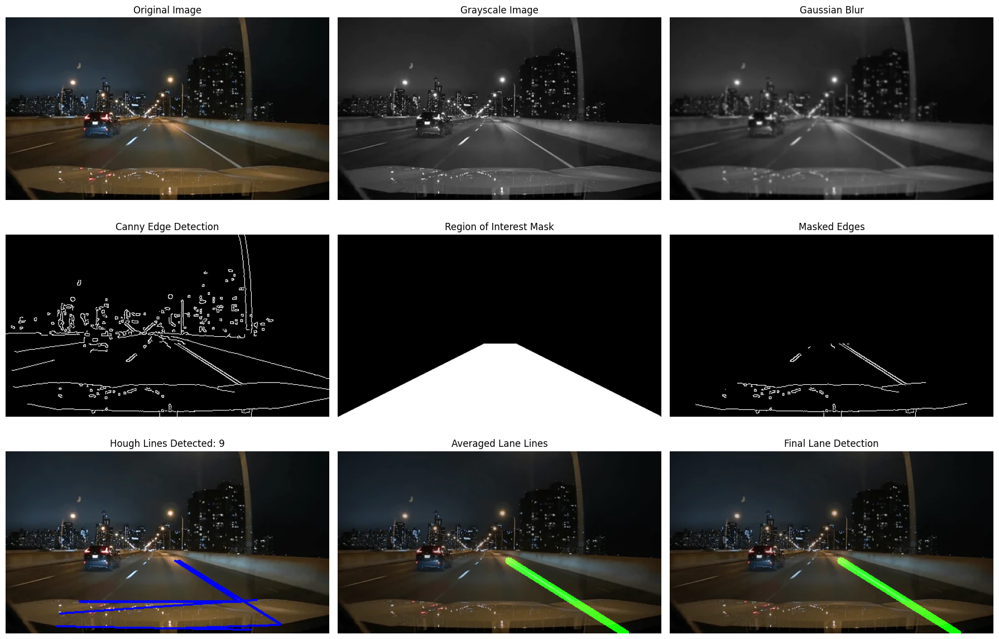

Total Hough lines detected: 9
Left lane lines: 0
Right lane lines: 4
Left lane detected: False
Right lane detected: True


In [19]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

img = cv2.imread('dash2.webp')

gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

blur = cv2.GaussianBlur(gray, (5, 5), 0)

edges = cv2.Canny(blur, 50, 150)

height = img.shape[0]
width = img.shape[1]

mask = np.zeros_like(edges)
polygon = np.array([[
    (0, height),
    (width * 0.45, height * 0.6),
    (width * 0.55, height * 0.6),
    (width, height)
]], np.int32)

cv2.fillPoly(mask, polygon, 255)
masked_edges = cv2.bitwise_and(edges, mask)

lines = cv2.HoughLinesP(masked_edges, 1, np.pi/180, 50, minLineLength=50, maxLineGap=150)

line_image = np.zeros_like(img)
left_lines = []
right_lines = []

if lines is not None:
    for line in lines:
        x1, y1, x2, y2 = line[0]
        if x2 != x1:
            slope = (y2 - y1) / (x2 - x1)
            if abs(slope) < 0.5:
                continue
            if slope < 0:
                left_lines.append(line[0])
            else:
                right_lines.append(line[0])

def average_lines(lines):
    if len(lines) == 0:
        return None
    x_coords = []
    y_coords = []
    for line in lines:
        x1, y1, x2, y2 = line
        x_coords.extend([x1, x2])
        y_coords.extend([y1, y2])
    poly = np.polyfit(x_coords, y_coords, 1)
    return poly

def draw_lane_line(img, poly, color):
    if poly is None:
        return
    height = img.shape[0]
    y1 = height
    y2 = int(height * 0.6)
    x1 = int((y1 - poly[1]) / poly[0])
    x2 = int((y2 - poly[1]) / poly[0])
    cv2.line(img, (x1, y1), (x2, y2), color, 10)

left_poly = average_lines(left_lines)
right_poly = average_lines(right_lines)

draw_lane_line(line_image, left_poly, (0, 255, 0))
draw_lane_line(line_image, right_poly, (0, 255, 0))

combined = cv2.addWeighted(img, 0.8, line_image, 1, 0)

lane_area = np.zeros_like(img)
if left_poly is not None and right_poly is not None:
    y1 = height
    y2 = int(height * 0.6)
    left_x1 = int((y1 - left_poly[1]) / left_poly[0])
    left_x2 = int((y2 - left_poly[1]) / left_poly[0])
    right_x1 = int((y1 - right_poly[1]) / right_poly[0])
    right_x2 = int((y2 - right_poly[1]) / right_poly[0])

    pts = np.array([[left_x1, y1], [left_x2, y2], [right_x2, y2], [right_x1, y1]], np.int32)
    cv2.fillPoly(lane_area, [pts], (0, 255, 0))

final_result = cv2.addWeighted(img, 0.8, lane_area, 0.3, 0)
final_result = cv2.addWeighted(final_result, 1, line_image, 1, 0)

plt.figure(figsize=(18, 12))

plt.subplot(3, 3, 1)
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.title('Original Image')
plt.axis('off')

plt.subplot(3, 3, 2)
plt.imshow(gray, cmap='gray')
plt.title('Grayscale Image')
plt.axis('off')

plt.subplot(3, 3, 3)
plt.imshow(blur, cmap='gray')
plt.title('Gaussian Blur')
plt.axis('off')

plt.subplot(3, 3, 4)
plt.imshow(edges, cmap='gray')
plt.title('Canny Edge Detection')
plt.axis('off')

plt.subplot(3, 3, 5)
plt.imshow(mask, cmap='gray')
plt.title('Region of Interest Mask')
plt.axis('off')

plt.subplot(3, 3, 6)
plt.imshow(masked_edges, cmap='gray')
plt.title('Masked Edges')
plt.axis('off')

plt.subplot(3, 3, 7)
hough_img = img.copy()
if lines is not None:
    for line in lines:
        x1, y1, x2, y2 = line[0]
        cv2.line(hough_img, (x1, y1), (x2, y2), (255, 0, 0), 2)
plt.imshow(cv2.cvtColor(hough_img, cv2.COLOR_BGR2RGB))
plt.title(f'Hough Lines Detected: {len(lines) if lines is not None else 0}')
plt.axis('off')

plt.subplot(3, 3, 8)
plt.imshow(cv2.cvtColor(combined, cv2.COLOR_BGR2RGB))
plt.title('Averaged Lane Lines')
plt.axis('off')

plt.subplot(3, 3, 9)
plt.imshow(cv2.cvtColor(final_result, cv2.COLOR_BGR2RGB))
plt.title('Final Lane Detection')
plt.axis('off')

plt.tight_layout()
plt.show()

print(f"Total Hough lines detected: {len(lines) if lines is not None else 0}")
print(f"Left lane lines: {len(left_lines)}")
print(f"Right lane lines: {len(right_lines)}")
print(f"Left lane detected: {left_poly is not None}")
print(f"Right lane detected: {right_poly is not None}")

## Coins Detection

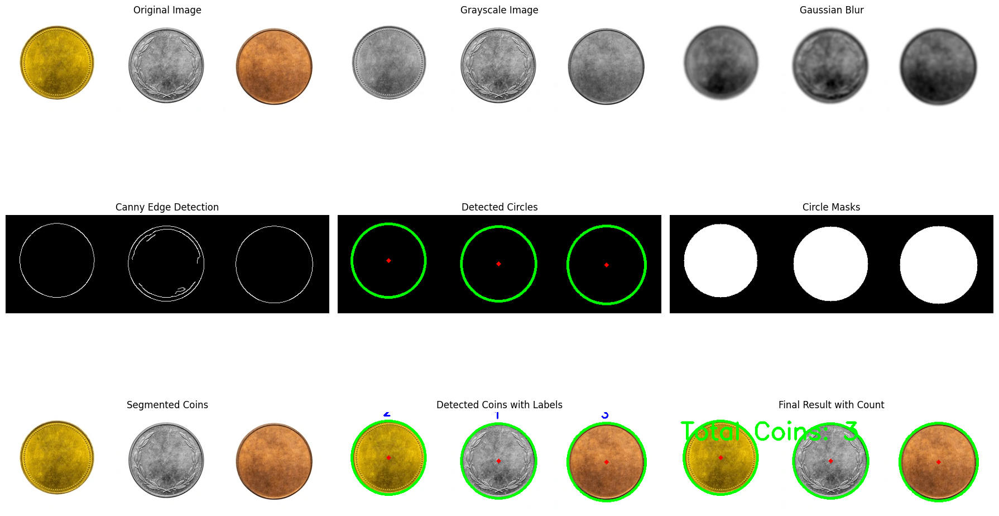

Total coins detected: 3

Coin details:
Coin 1: Center=(298, 90), Radius=69
Coin 2: Center=(94, 84), Radius=68
Coin 3: Center=(498, 92), Radius=72


In [22]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

img = cv2.imread('3 coins.webp')

output = img.copy()

gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

blurred = cv2.GaussianBlur(gray, (9, 9), 2)

edges = cv2.Canny(blurred, 50, 150)

circles = cv2.HoughCircles(
    blurred,
    cv2.HOUGH_GRADIENT,
    dp=1,
    minDist=50,
    param1=100,
    param2=30,
    minRadius=20,
    maxRadius=100
)

coin_count = 0
detected_image = img.copy()
circles_only = np.zeros_like(img)

if circles is not None:
    circles = np.uint16(np.around(circles))
    coin_count = len(circles[0])

    for i, (x, y, r) in enumerate(circles[0, :]):
        cv2.circle(detected_image, (x, y), r, (0, 255, 0), 3)
        cv2.circle(detected_image, (x, y), 2, (0, 0, 255), 3)
        cv2.putText(detected_image, str(i+1), (x-10, y-r-10),
                   cv2.FONT_HERSHEY_SIMPLEX, 0.7, (255, 0, 0), 2)

        cv2.circle(circles_only, (x, y), r, (0, 255, 0), 3)
        cv2.circle(circles_only, (x, y), 2, (0, 0, 255), 3)

mask_circles = np.ones(gray.shape, dtype=np.uint8)
if circles is not None:
    for (x, y, r) in circles[0, :]:
        cv2.circle(mask_circles, (x, y), r, 255, -1)

masked_coins = cv2.bitwise_and(img, img, mask=mask_circles)

plt.figure(figsize=(18, 12))

plt.subplot(3, 3, 1)
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.title('Original Image')
plt.axis('off')

plt.subplot(3, 3, 2)
plt.imshow(gray, cmap='gray')
plt.title('Grayscale Image')
plt.axis('off')

plt.subplot(3, 3, 3)
plt.imshow(blurred, cmap='gray')
plt.title('Gaussian Blur')
plt.axis('off')

plt.subplot(3, 3, 4)
plt.imshow(edges, cmap='gray')
plt.title('Canny Edge Detection')
plt.axis('off')

plt.subplot(3, 3, 5)
plt.imshow(cv2.cvtColor(circles_only, cv2.COLOR_BGR2RGB))
plt.title('Detected Circles')
plt.axis('off')

plt.subplot(3, 3, 6)
plt.imshow(mask_circles, cmap='gray')
plt.title('Circle Masks')
plt.axis('off')

plt.subplot(3, 3, 7)
plt.imshow(cv2.cvtColor(masked_coins, cv2.COLOR_BGR2RGB))
plt.title('Segmented Coins')
plt.axis('off')

plt.subplot(3, 3, 8)
plt.imshow(cv2.cvtColor(detected_image, cv2.COLOR_BGR2RGB))
plt.title(f'Detected Coins with Labels')
plt.axis('off')

plt.subplot(3, 3, 9)
result_text = img.copy()
cv2.putText(result_text, f'Total Coins: {coin_count}', (20, 50),
           cv2.FONT_HERSHEY_SIMPLEX, 1.5, (0, 255, 0), 3)
if circles is not None:
    for i, (x, y, r) in enumerate(circles[0, :]):
        cv2.circle(result_text, (x, y), r, (0, 255, 0), 3)
        cv2.circle(result_text, (x, y), 2, (0, 0, 255), 3)
plt.imshow(cv2.cvtColor(result_text, cv2.COLOR_BGR2RGB))
plt.title('Final Result with Count')
plt.axis('off')

plt.tight_layout()
plt.show()

print(f"Total coins detected: {coin_count}")
if circles is not None:
    print(f"\nCoin details:")
    for i, (x, y, r) in enumerate(circles[0, :]):
        print(f"Coin {i+1}: Center=({x}, {y}), Radius={r}")

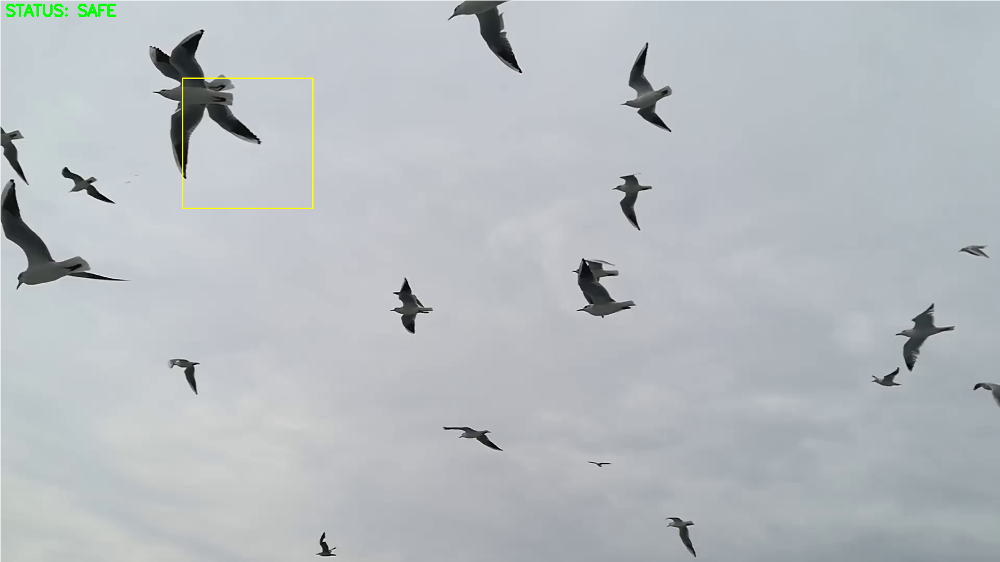

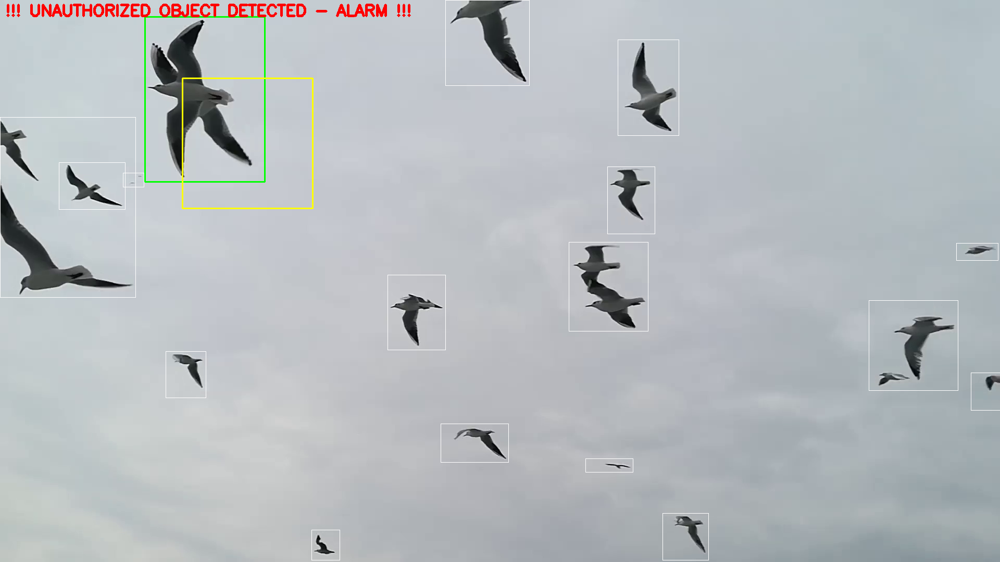

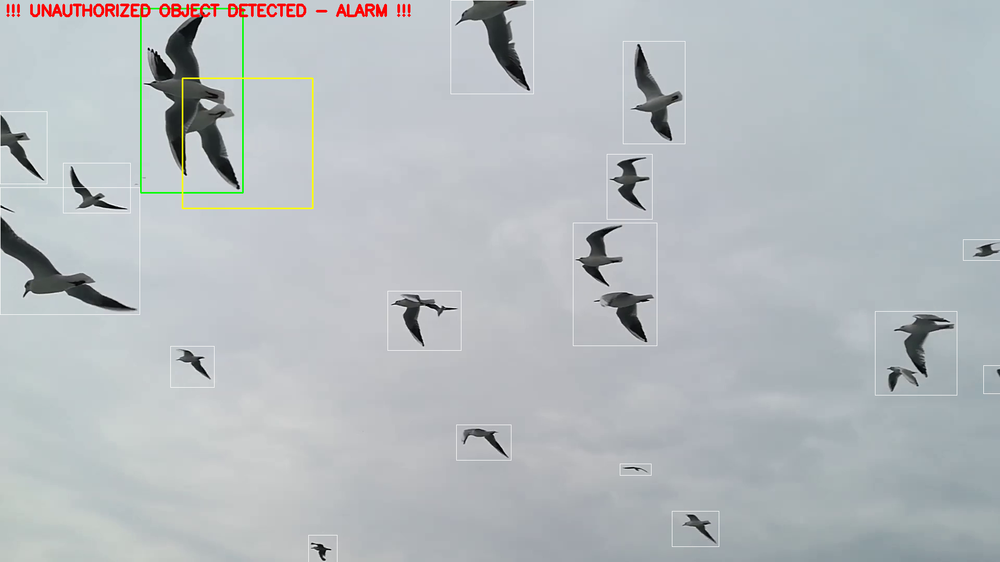

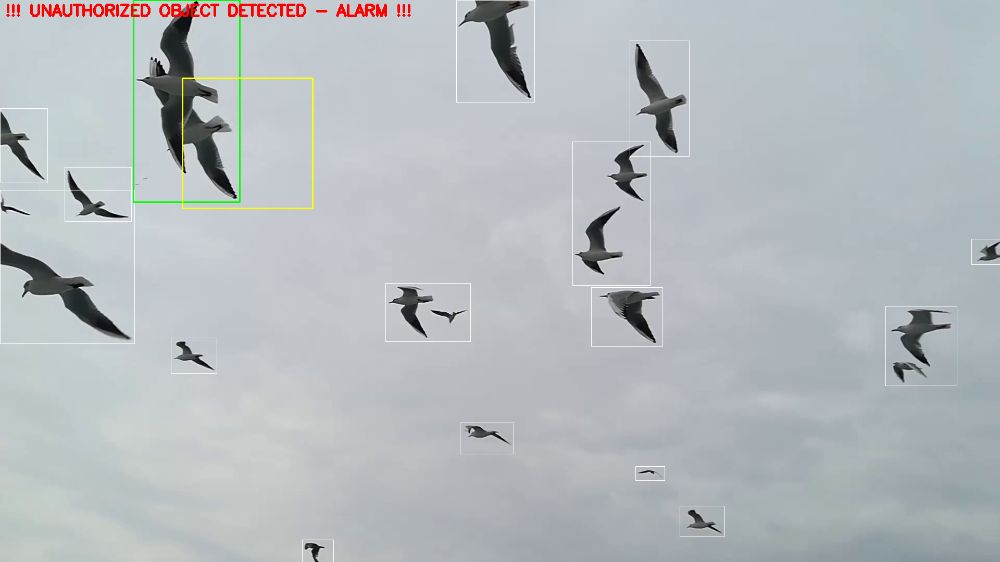

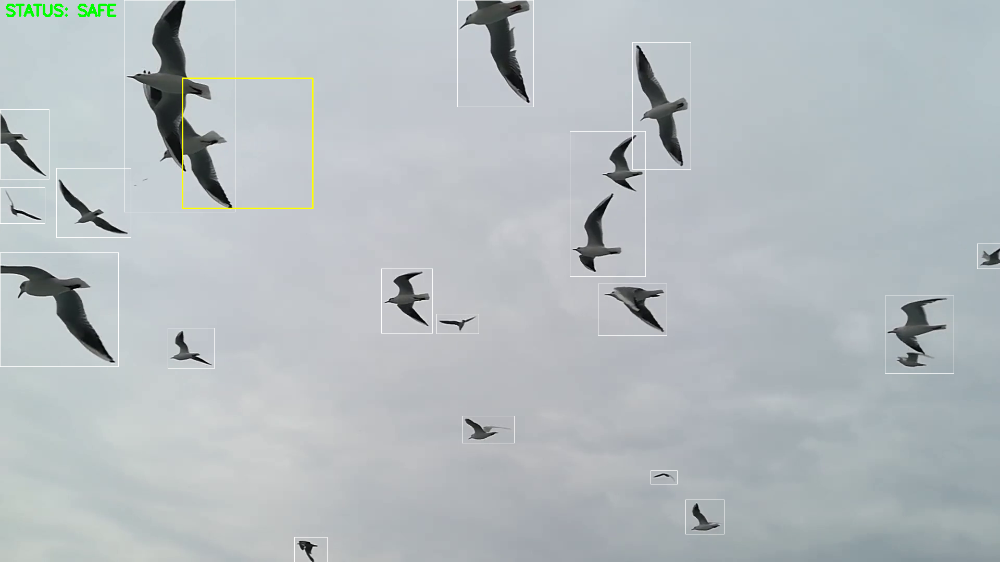

...

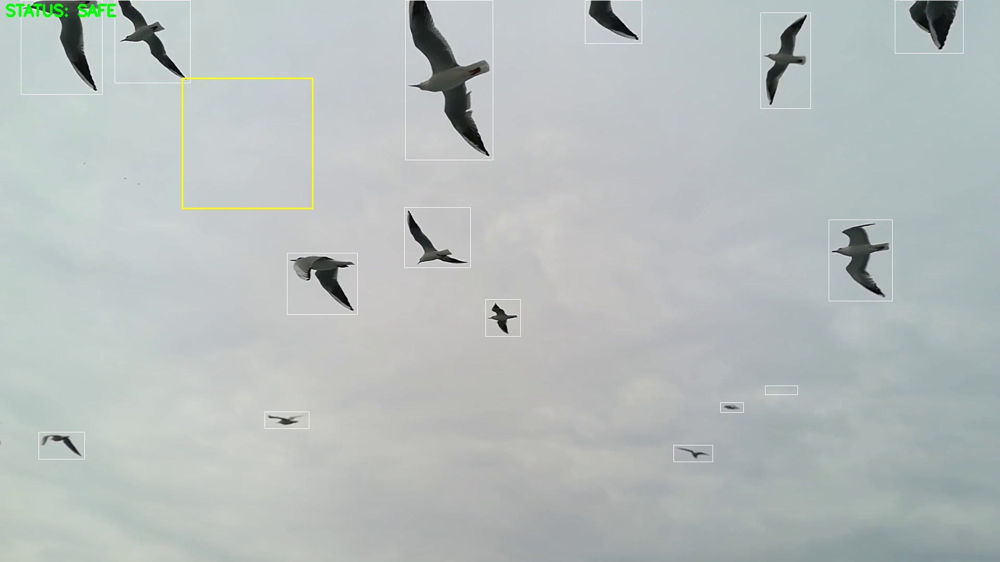

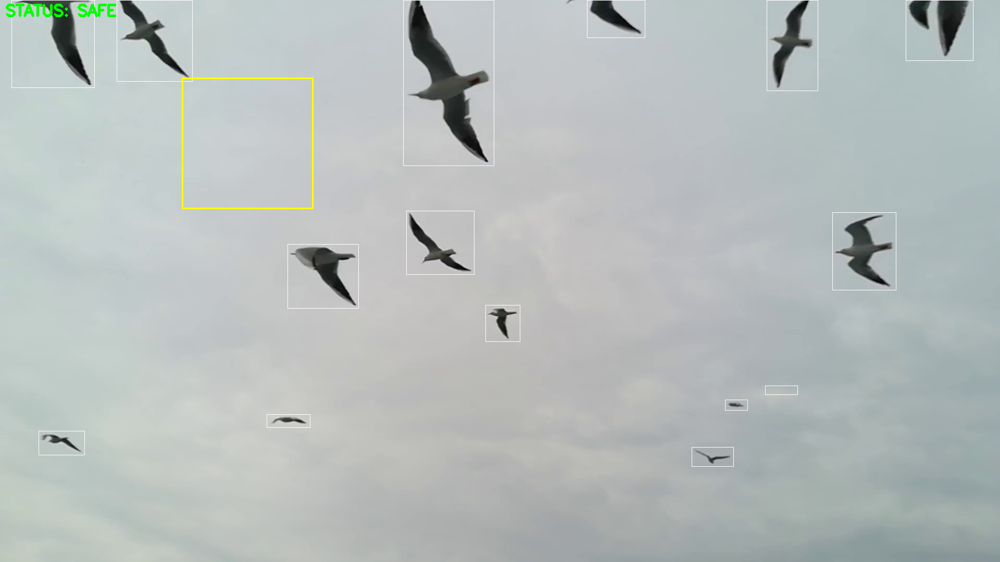

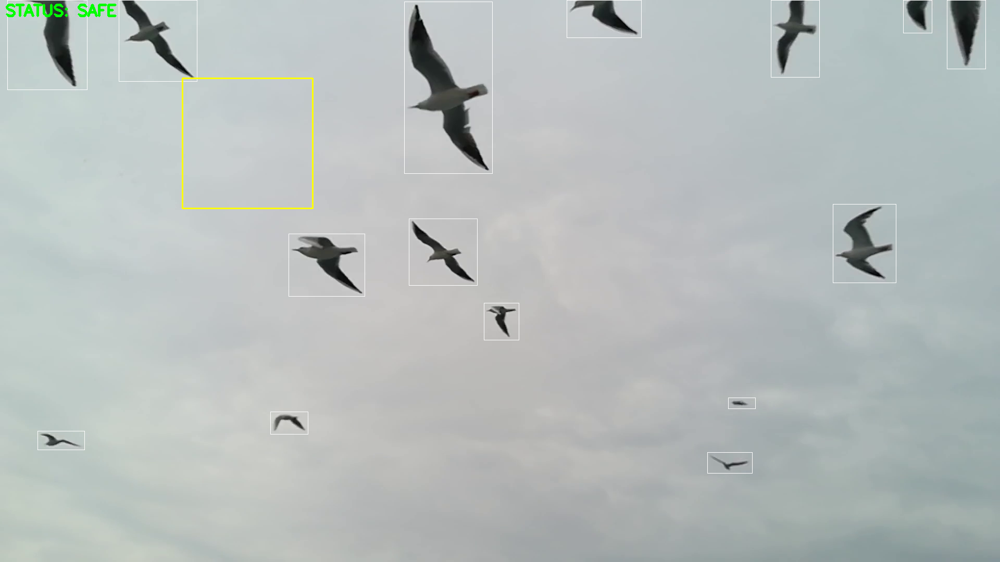

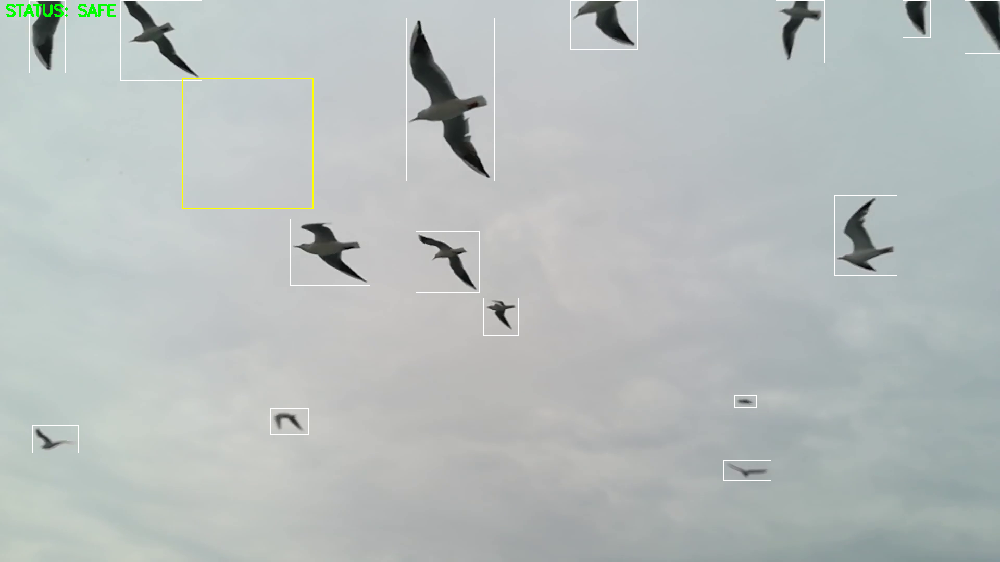

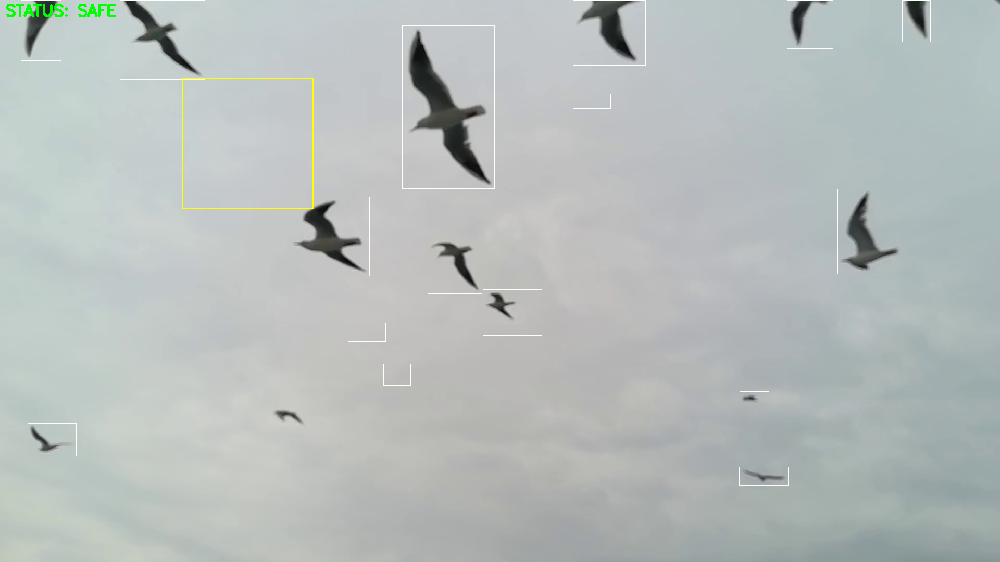

KeyboardInterrupt: 

In [41]:
import cv2
import numpy as np

cap = cv2.VideoCapture('birds.mp4')
fgbg = cv2.createBackgroundSubtractorMOG2(history=500, varThreshold=16, detectShadows=True)

alarm_state = False
min_area = 500

max_frames = 100
frame_count = 0

# Define Security Zone (ROI)
roi_x, roi_y = 350, 150
roi_w, roi_h = 250, 250
roi_color = (0, 255, 255)

while True:
    ret, frame = cap.read()

    if not ret or frame_count >= max_frames:
        break

    frame_count += 1

    # Background Subtraction and Noise Reduction
    fgmask = fgbg.apply(frame)
    fgmask = cv2.GaussianBlur(fgmask, (5, 5), 0)

    kernel = np.ones((5, 5), np.uint8)
    fgmask = cv2.dilate(fgmask, kernel, iterations=2)
    fgmask = cv2.erode(fgmask, kernel, iterations=1)

    # Contour Detection
    contours, _ = cv2.findContours(fgmask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    alarm_state = False

    # Object/Boundary Check
    for contour in contours:
        area = cv2.contourArea(contour)

        if area > min_area:
            x, y, w, h = cv2.boundingRect(contour)

            center_x = x + w // 2
            center_y = y + h // 2

            if (center_x > roi_x and center_x < roi_x + roi_w and
                center_y > roi_y and center_y < roi_y + roi_h):

                cv2.rectangle(frame, (x, y), (x + w, y + h), (0, 255, 0), 2)
                alarm_state = True

            else:
                cv2.rectangle(frame, (x, y), (x + w, y + h), (255, 255, 255), 1)

    # Drawing and Status Display
    cv2.rectangle(frame, (roi_x, roi_y), (roi_x + roi_w, roi_y + roi_h), roi_color, 2)

    status_text = "STATUS: SAFE"
    text_color = (0, 255, 0)
    if alarm_state:
        status_text = "!!! UNAUTHORIZED OBJECT DETECTED - ALARM !!!"
        text_color = (0, 0, 255)

    cv2.putText(frame, status_text, (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, text_color, 3)

    cv2_imshow(frame)

cap.release()